In [1]:
import os

import gym
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torch.autograd as autograd
import matplotlib.pyplot as plt

from itertools import count
from collections import namedtuple
from torch.autograd import Variable
from gridworld import GridworldEnv


# parser = argparse.ArgumentParser(description='PyTorch actor-critic example')
# parser.add_argument('--gamma', type=float, default=0.99, metavar='G',
#                     help='discount factor (default: 0.99)')
# parser.add_argument('--seed', type=int, default=543, metavar='N',
#                     help='random seed (default: 1)')
# parser.add_argument('--render', action='store_true',
#                     help='render the environment')
# parser.add_argument('--log-interval', type=int, default=10, metavar='N',
#                     help='interval between training status logs (default: 10)')
# args = parser.parse_args()

gamma_rl = 0.99

In [2]:
%matplotlib inline

In [3]:
env = GridworldEnv(shape=(5, 5))

In [4]:
# env = gym.make('MountainCar-v0')
# env.seed(args["seed"])
# torch.manual_seed(args["seed"])

In [5]:
def entropy_term(probs):
    return -torch.sum(probs * torch.log(probs))

In [6]:
#state_dim = 2 * len(env.state)
state_dim = int(env.nS * 2)
action_dim = int(env.nA)

hidden_layer1_size = 50
hidden_layer2_size = 50

lambda_baseline = 0.1

entropy_weights = {
    "Alice":0.0,
    "Bob":0.00,
}


In [7]:
SavedAction = namedtuple('SavedAction', ['action', 'prob', 'value'])
class Policy(nn.Module):
    def __init__(self, state_dim, action_dim):
        super(Policy, self).__init__()
        self.affine1 = nn.Linear(state_dim, hidden_layer1_size)
        nn.init.xavier_normal(self.affine1.weight)
        self.action_head = nn.Linear(hidden_layer2_size, action_dim)
        nn.init.xavier_normal(self.action_head.weight)
        self.value_head = nn.Linear(hidden_layer2_size, 1)
        nn.init.xavier_normal(self.value_head.weight)

        self.saved_actions = []
        self.rewards = []

    def forward(self, s, s_star=None):
        x_onehot = torch.zeros((1, state_dim))
        x_onehot[0][s] = 1
        if(not (s_star is None)):
            x_onehot[0][state_dim // 2 + s_star] = 1
        x_onehot = Variable(x_onehot)
        x = F.relu(self.affine1(x_onehot))
        action_scores = self.action_head(x)
        state_values = self.value_head(x)
        return F.softmax(action_scores), state_values

In [8]:
def select_action(state, s_star, model):
    #state = torch.from_numpy(state).int().unsqueeze(0)
    probs, state_value = model(state, s_star)
    action = probs.multinomial()
    model.saved_actions.append(SavedAction(action, probs, state_value))
    return action.data

In [9]:
def update_params(model, optimizer, who="Alice"):
    R = 0
    saved_actions = model.saved_actions
    value_loss = 0
    entropy_loss = 0
    rewards = []
    for r in model.rewards[::-1]:
        R = r + gamma_rl * R
        rewards.insert(0, R)
    rewards = torch.Tensor(rewards)
    for (action, probs, value), r in zip(saved_actions, rewards):
        reward = r - value.data[0, 0]
        action.reinforce(reward)
        value_loss += lambda_baseline * F.mse_loss(value, Variable(torch.Tensor([r])))
        entropy_loss += -entropy_weights[who] * entropy_term(probs)

    optimizer.zero_grad()
    final_nodes = [value_loss] + [entropy_loss] + list(map(lambda p: p.action, saved_actions))
    gradients = [torch.ones(1)] + [torch.ones(1)] + [None] * len(saved_actions)
    
    autograd.backward(final_nodes, gradients)
    optimizer.step()

    del model.rewards[:]
    del model.saved_actions[:]


In [10]:
def check_equivalence(s1, s2, eps=1e-9):
    return np.sum((s1 - s2) ** 2) < eps
    

In [11]:
def set_random_s0(env):
    rand_s0 = np.random.randint(12, 13)
    #rand_s0 = np.random.randint(0, env.nS)
    
    for i in range(len(env.isd)):
        env.isd[i] = 0
    
    env.isd[rand_s0] = 1
    

In [12]:
from collections import defaultdict

In [13]:
def add_timestep(timesteps, env, t):
    timestep = defaultdict()
    timestep["time"] = t
    if(len(timesteps)):
        timestep["timestep_duration"] = t - timesteps[-1]["time"]
    else:
        timestep["timestep_duration"] = t
    
    timestep["s_star"] = env.s
    
    timesteps.append(timestep)

def self_play_episode(env, tmax, model_Alice, timestep_length, model_Bob, pretraining_type="Repeat", is_gridworld=True):
    
    Alice_timesteps = []
    if(pretraining_type == "Repeat" and is_gridworld):
        set_random_s0(env)
    else:
        raise TypeError("This Pretrainig type or environment is not realized")
    
    s0 = env.reset()
#     if pretraining_type == "Reverse":
#         s_star = s0
    #Alice term
    tA = 0
    done = False
    while True:
        tA = tA + 1
        a = select_action(env.s, s0, model_Alice)
        if a[0,0] == env.action_space.n or tA >= tmax:
            s_star = env.s
            add_timestep(Alice_timesteps, env, tA)
            env.reset()  
            model_Alice.rewards.append(0) #will be changed during Bob's interaction
            break
        
        if(tA % timestep_length == 0):
            add_timestep(Alice_timesteps, env, tA)

        state, _, done, _= env.step(a[0, 0])
        model_Alice.rewards.append(0) #will be changed during Bob's interaction
    
    #Bob term
    tB = 0
    Bob_timesteps = []
    done = False
    for i, Alice_timestep in enumerate(Alice_timesteps):
        timestep_time_Bob = 0
        next_s_star = Alice_timestep["s_star"]
        stop_Bob = (check_equivalence(np.array(env.s), np.array(next_s_star)) or (tB + tA >= tmax))
        while(not stop_Bob):
            tB += 1
            timestep_time_Bob += 1
            a = select_action(env.s, next_s_star, model_Bob)
            state, _, done, _= env.step(a[0, 0])
            
            stop_Bob = (check_equivalence(np.array(env.s), np.array(next_s_star)) or (tB + tA >= tmax))
            if(not stop_Bob):
                model_Bob.rewards.append(0);
            else:
                model_Bob.rewards.append(-scale_self_play * timestep_time_Bob)
    
        model_Alice.rewards[Alice_timestep["time"] - 1] = scale_self_play * max(0, timestep_time_Bob - Alice_timestep["timestep_duration"])
        add_timestep(Bob_timesteps, env, tB)
    
    rewards_Alice_copy = copy.deepcopy(model_Alice.rewards[:])
    rewards_Bob_copy = copy.deepcopy(model_Bob.rewards[:])
    
    if(len(model_Bob.saved_actions)):
        update_params(model_Bob, optimizer_Bob, "Bob")
    else:
        del model_Bob.rewards[:]
    if(len(model_Alice.saved_actions)):
        update_params(model_Alice, optimizer_Alice, "Alice")
    else:
        del model_Alice.rewards[:]
    
    Alice_cum_reward = 0.0
    for r in rewards_Alice_copy[::-1]:
        Alice_cum_reward  = r + gamma_rl * Alice_cum_reward
    
    Bob_cum_reward = 0.0
    for r in rewards_Bob_copy[::-1]:
        Bob_cum_reward  = r + gamma_rl * Bob_cum_reward
        
    return (Alice_cum_reward, Bob_cum_reward), (Alice_timesteps, Bob_timesteps)
    

In [14]:
lr_Alice = 1e-2
lr_Bob = 1e-2

scale_self_play = 0.1

In [15]:
action_dim

4

In [16]:
model_Alice = Policy(state_dim, action_dim + 1)
model_Bob = Policy(state_dim, action_dim)

#optimizer_Alice = optim.SGD(model_Alice.parameters(), lr=lr_Alice)
#optimizer_Bob = optim.SGD(model_Bob.parameters(), lr=lr_Bob)

optimizer_Alice = optim.RMSprop(model_Alice.parameters(), alpha=0.97, eps=1e-6, lr=lr_Alice)
optimizer_Bob = optim.RMSprop(model_Bob.parameters(), alpha=0.97, eps=1e-6, lr=lr_Bob)

In [17]:
from tqdm import tnrange

def pretrain_model(env, tmax, model_Alice, timestep_length, model_Bob, episodes, pretraining_type="Repeat"):
    Alice_rewards = []
    Bob_rewards = []
    
    Bob_episode_timesteps = []
    Alice_episode_timesteps = []
    for i in range(episodes):
        #print("Episode %d:" % (i + 1))
        res = self_play_episode(env, tmax, model_Alice, timestep_length, model_Bob, pretraining_type)
        Alice_rewards.append(res[0][0])
        Bob_rewards.append(res[0][1])
        Alice_episode_timesteps.append(res[1][0])
        Bob_episode_timesteps.append(res[1][1])
            
    return model_Alice, model_Bob, Alice_rewards, Bob_rewards, Alice_episode_timesteps, Bob_episode_timesteps

In [18]:
import copy
model_Bob_old = copy.deepcopy(model_Bob)
model_Alice_old = copy.deepcopy(model_Alice)

In [19]:
!mkdir one_step
plots_dir = "one_step"

mkdir: one_step: File exists


Widget Javascript not detected.  It may not be installed properly. Did you enable the widgetsnbextension? If not, then run "jupyter nbextension enable --py --sys-prefix widgetsnbextension"
/Users/andrejklimkin/anaconda/lib/python3.5/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


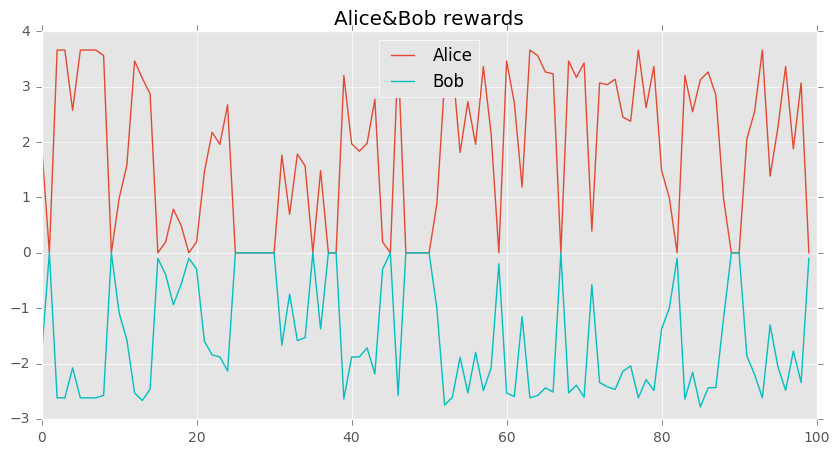

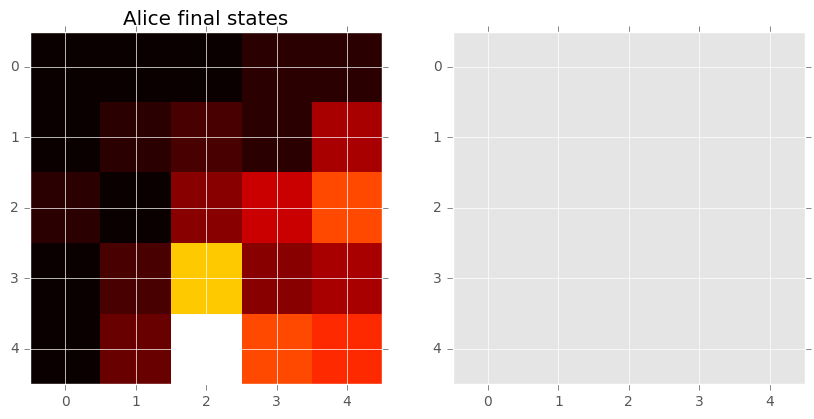

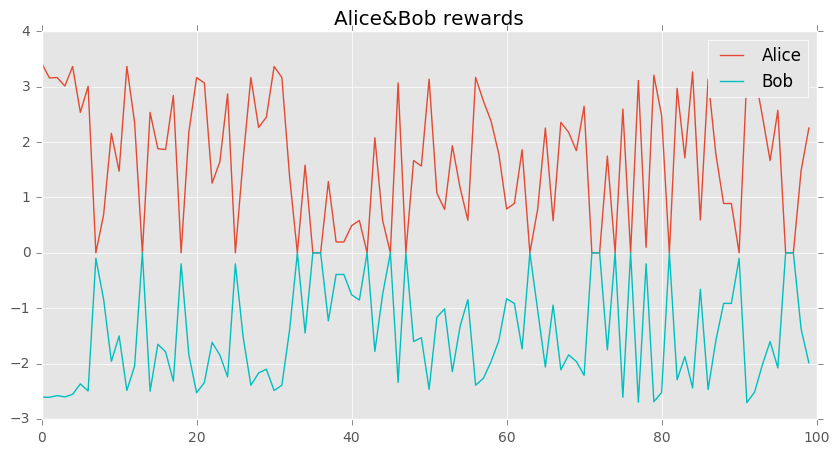

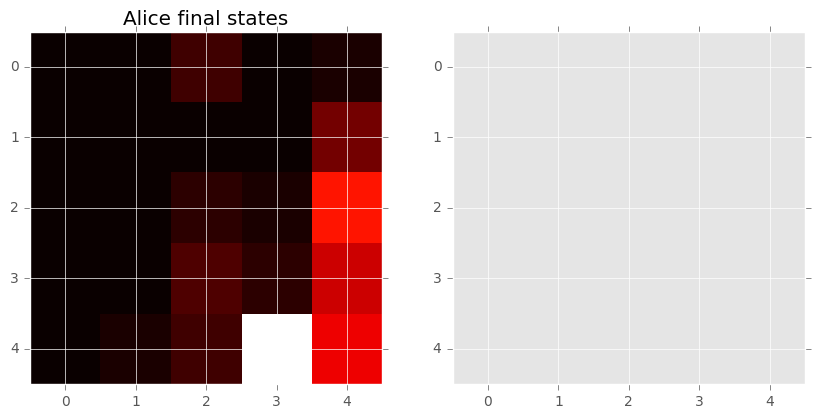

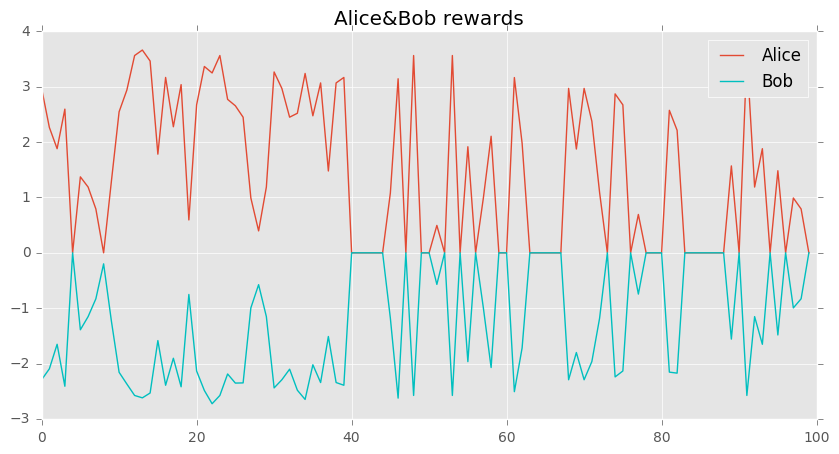

...

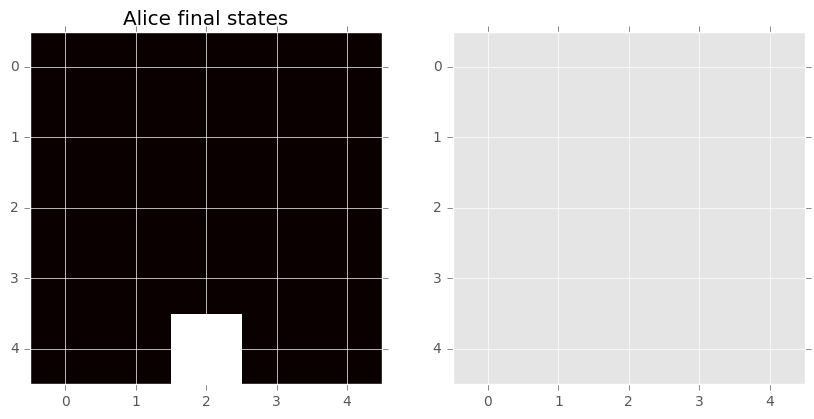

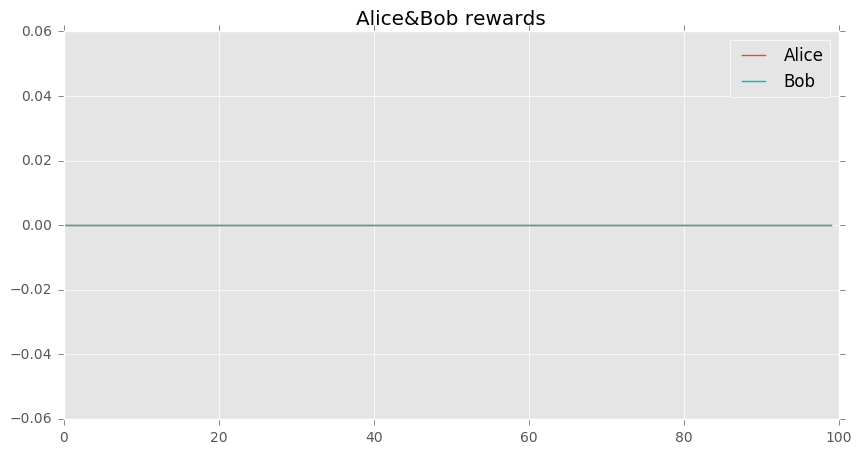

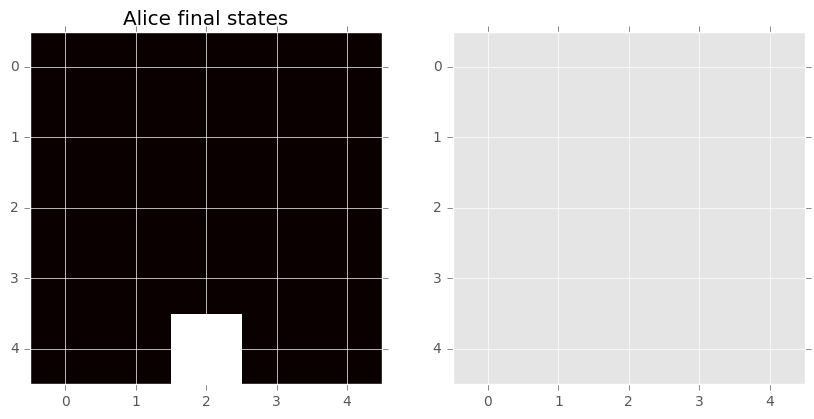

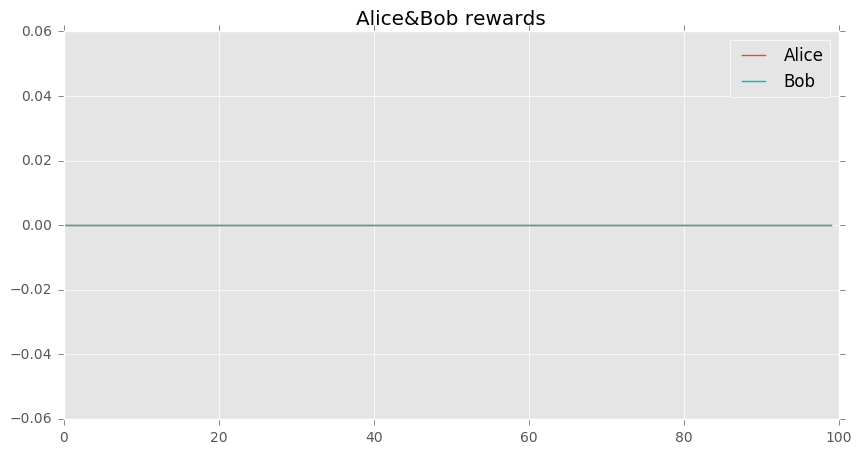

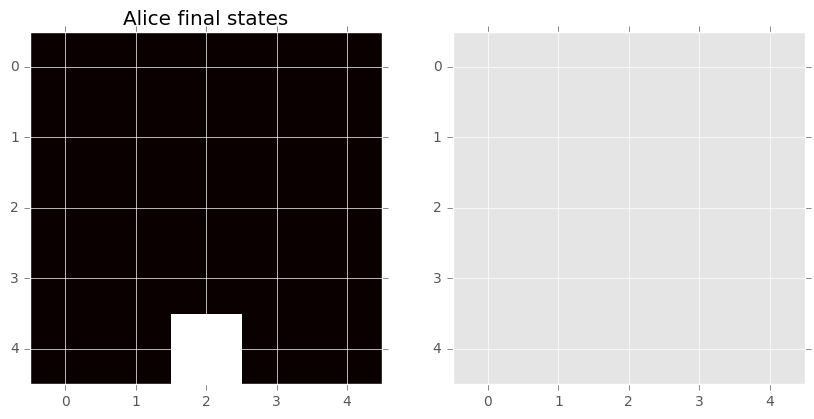

In [20]:
import matplotlib
matplotlib.style.use("ggplot")
episodes_step = 100
Alice_timestep_length = 1
times = 1000
start = 0
draw_every = 1


for i in tnrange(times):
    model_Alice, model_Bob, Alice_rewards, Bob_rewards, Alice_timesteps, Bob_timesteps = pretrain_model(env, 40, model_Alice, Alice_timestep_length, 
                                                                          model_Bob, episodes_step, pretraining_type="Repeat")
#     Alice_cum_reward = 0.0
#     for r in rewards[0][::-1]:
#         Alice_cum_reward  = r + gamma_rl * Alice_cum_reward
    
#     Bob_cum_reward = 0.0
#     for r in rewards[1][::-1]:
#         Bob_cum_reward  = r + gamma_rl * Bob_cum_reward
    
#     Alice_rewards.append(Alice_cum_reward)
#     Bob_rewards.append(Bob_cum_reward)
#     print("%d Epoch of learning past" % (i + 1))
#     print("Alice reward = %.3f" % Alice_cum_reward)
#     print("Bob reward = %.3f" % Bob_cum_reward)
#     print("-" * 100)
    if(i % draw_every == 0):
        fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 5))
        ax.plot(np.array(Alice_rewards), label="Alice")
        ax.plot(np.array(Bob_rewards), color='c', label="Bob")
        ax.set_title("Alice&Bob rewards")
        ax.legend(loc="best")
        plt.savefig(plots_dir + "/reward_plot{}".format(episodes_step * (start + i + 1)))
#     dense_Alice = np.zeros((5, 5))
#     for finish in finish_states[:, 0]:
#         dense_Alice[finish // 5][finish % 5] += 1

    dense_Alice = np.zeros((5, 5))
    final_states_Alice = [timestep[-1]["s_star"] for timestep in Alice_timesteps]
    for finish in final_states_Alice:
        dense_Alice[finish // 5][finish % 5] += 1
        
    dense_Bob = np.zeros((5, 5))
    final_states_Bob = [timestep[-1]["s_star"] for timestep in Bob_timesteps]
    for finish in final_states_Bob:
        dense_Bob[finish // 5][finish % 5] += 1
    
    fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))
    ax[0].imshow(dense_Alice, cmap='hot', interpolation='nearest')
    ax[0].set_title("Alice final states")
    ax[1].imshow(dense_Bob, cmap='hot', interpolation='nearest')
    ax[1].set_title("Bob final states")
    plt.savefig(plots_dir + "/final_states{}".format(episodes_step * (start + i + 1)))
    plt.cla()
    
#     fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 5))
#     ax.hist(finish_states[:, 0], alpha=0.5, label="Alice")
#     ax[2].hist(finish_states[:, 1], color='c', alpha=0.5, label="Bob")


#     ax[1].imshow(dense_Bob, cmap='hot', interpolation='nearest')
#     ax[1].set_title("Bob final states")
    
#     plt.savefig(plots_dir + "/final_states{}".format(episodes_step * (start + i + 1)))
#     plt.cla()
    
#     fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(12, 4))
#     ax[0].plot(rewards[:, 0], label="Alice")
#     ax[1].plot(time[:, 0], label="Alice")

#     ax[2].hist(finish_states[:, 0], alpha=0.5, label="Alice")
#     ax[2].hist(finish_states[:, 1], color='c', alpha=0.5, label="Bob")
#     ax[0].plot(rewards[:, 1], color='c', label="Bob")


#     ax[0].set_xlabel("episode")
#     ax[1].set_xlabel("episode")
#     ax[1].set_ylabel("steps")
#     ax[0].set_ylabel("reward")
#     ax[2].set_xlabel("final state")
#     ax[2].set_ylabel("distribution")
#     ax[0].legend(loc="best")
#     ax[1].legend(loc="best")
#     ax[2].legend(loc="best")
#     fig.tight_layout()
    
#     plt.savefig(plots_dir + "/reward_time_final{}".format(episodes_step * (start + i + 1)))
#     plt.cla()

In [42]:
probs, state_value = model_Alice(12, 12)
print(probs)

Variable containing:
 2.4268e-04  1.6236e-01  8.3735e-01  7.8836e-06  3.0550e-05
[torch.FloatTensor of size 1x5]



In [45]:
probs, state_value = model_Bob(12, 17)
print(probs)

Variable containing:
 0.0003  0.9989  0.0006  0.0002
[torch.FloatTensor of size 1x4]



In [35]:
len(rewards[0]) + len(rewards[1])

9

In [34]:
d = defaultdict(None)
d["1"] = 1
d

defaultdict(None, {'1': 1})

In [69]:
torch.zeros((1, 5))[0][4]

0.0

In [70]:
state = np.array([13, 4])
state = torch.from_numpy(state).float().unsqueeze(0)
probs, state_value = model_Alice_old(Variable(state))
print(probs)
print(state_value)

IndexError: When performing advanced indexing the indexing objects must be LongTensors or convertible to LongTensors

In [ ]:
state = np.array([22, 20])
state = torch.from_numpy(state).float().unsqueeze(0)
model_Bob(Variable(state))


NameError: name 'rewards' is not defined

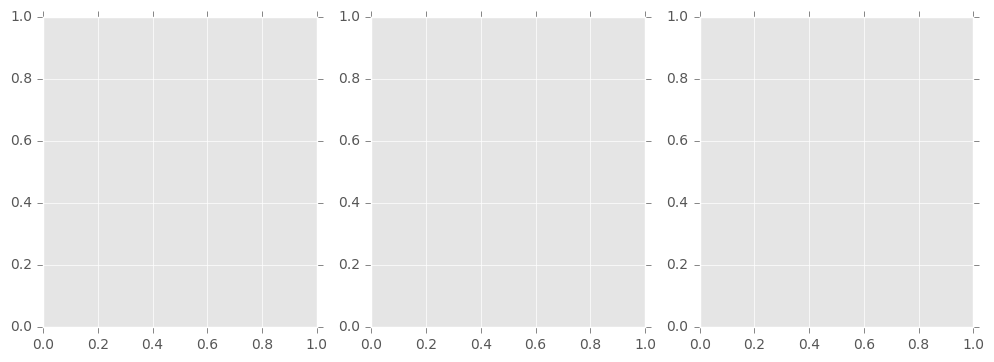

In [149]:
#10000 episodes, tmax=25, lr=1e-4, gamma=0.1
plt.style.use("ggplot")
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(12, 4))
ax[0].plot(rewards[:, 0], label="Alice")
ax[1].plot(time[:, 0], label="Alice")

ax[2].hist(finish_states[:, 0], alpha=0.5, label="Alice")
ax[2].hist(finish_states[:, 1], color='c', alpha=0.5, label="Bob")
ax[0].plot(rewards[:, 1], color='c', label="Bob")


ax[0].set_xlabel("episode")
ax[1].set_xlabel("episode")
ax[1].set_ylabel("steps")
ax[0].set_ylabel("reward")
ax[2].set_xlabel("final state")
ax[2].set_ylabel("distribution")
ax[0].legend(loc="best")
ax[1].legend(loc="best")
ax[2].legend(loc="best")
#ax[1][1].plot(time[:, 1], color='c')
#ax[1][2].hist(finish_states[:, 1], color='c')
fig.tight_layout()
#ax[0].subplots("Alice")
#eps = 1e-6

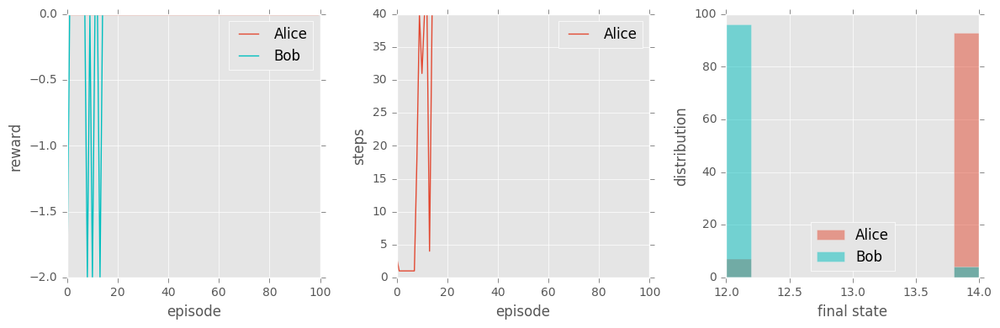

In [52]:
#10000 episodes, tmax=25, lr=1e-4, gamma=0.1
plt.style.use("ggplot")
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(12, 4))
ax[0].plot(rewards[:, 0], label="Alice")
ax[1].plot(time[:, 0], label="Alice")

ax[2].hist(finish_states[:, 0], alpha=0.5, label="Alice")
ax[2].hist(finish_states[:, 1], color='c', alpha=0.5, label="Bob")
ax[0].plot(rewards[:, 1], color='c', label="Bob")


ax[0].set_xlabel("episode")
ax[1].set_xlabel("episode")
ax[1].set_ylabel("steps")
ax[0].set_ylabel("reward")
ax[2].set_xlabel("final state")
ax[2].set_ylabel("distribution")
ax[0].legend(loc="best")
ax[1].legend(loc="best")
ax[2].legend(loc="best")
#ax[1][1].plot(time[:, 1], color='c')
#ax[1][2].hist(finish_states[:, 1], color='c')
fig.tight_layout()
#ax[0].subplots("Alice")
#eps = 1e-6

In [1767]:
rewards

array([[ 0. , -0. ],
       [ 0.1, -1.3],
       [ 0. , -0.4],
       [ 1.9, -2.2],
       [ 0.3, -1.4],
       [ 1.7, -2.1],
       [ 0. , -0.2],
       [ 1.9, -2.2],
       [ 0. , -0.4],
       [ 0. , -0. ],
       [ 0.7, -1.6],
       [ 0.9, -1.7],
       [ 0. , -1. ],
       [ 1.3, -1.9],
       [ 0.5, -1.5],
       [ 0.3, -1.4],
       [ 0. , -0.8],
       [ 0.9, -1.7],
       [ 0. , -0.3],
       [ 1.3, -1.9],
       [ 0. , -0.5],
       [ 2. , -2.2],
       [ 0.5, -1.5],
       [ 1.9, -2.2],
       [ 1.7, -2.1],
       [ 0. , -0.1],
       [ 2.1, -2.3],
       [ 0. , -1. ],
       [ 2.1, -2.3],
       [ 0.3, -1.4],
       [ 0. , -1. ],
       [ 0.3, -1.4],
       [ 1.5, -2. ],
       [ 0.9, -1.7],
       [ 0.9, -1.7],
       [ 1.9, -2.2],
       [ 1.9, -2.2],
       [ 0.9, -1.7],
       [ 0. , -1.2],
       [ 0.7, -0.9],
       [ 1.9, -2.2],
       [ 1.9, -2.2],
       [ 1.9, -2.2],
       [ 0. , -0. ],
       [ 1.9, -2.2],
       [ 1.9, -2.2],
       [ 0. , -0. ],
       [ 1.7,

In [ ]:
model_Bob10000, rewards10000, time, finish_states10000 = model_Bob, rewards, time, finish_states

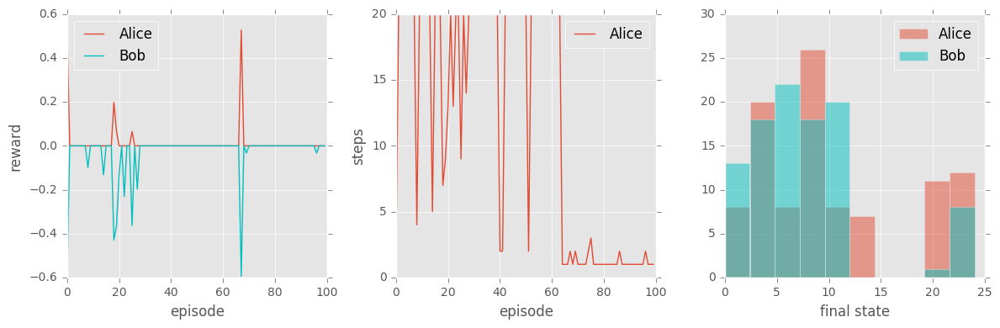

In [864]:
#1000 episodes, tmax=20, lr=1e-2
import matplotlib.pyplot as plt
plt.style.use("ggplot")
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(12, 4))
ax[0].plot(rewards[:, 0], label="Alice")
ax[1].plot(time[:, 0], label="Alice")
ax[2].hist(finish_states[:, 0], alpha=0.5, label="Alice")
ax[2].hist(finish_states[:, 1], color='c', alpha=0.5, label="Bob")
ax[0].plot(rewards[:, 1], color='c', label="Bob")
ax[0].set_xlabel("episode")
ax[1].set_xlabel("episode")
ax[1].set_ylabel("steps")
ax[0].set_ylabel("reward")
ax[2].set_xlabel("final state")
ax[0].legend(loc="best")
ax[1].legend(loc="best")
ax[2].legend(loc="best")
#ax[1][1].plot(time[:, 1], color='c')
#ax[1][2].hist(finish_states[:, 1], color='c')
fig.tight_layout()
#ax[0].subplots("Alice")
#eps = 1e-6

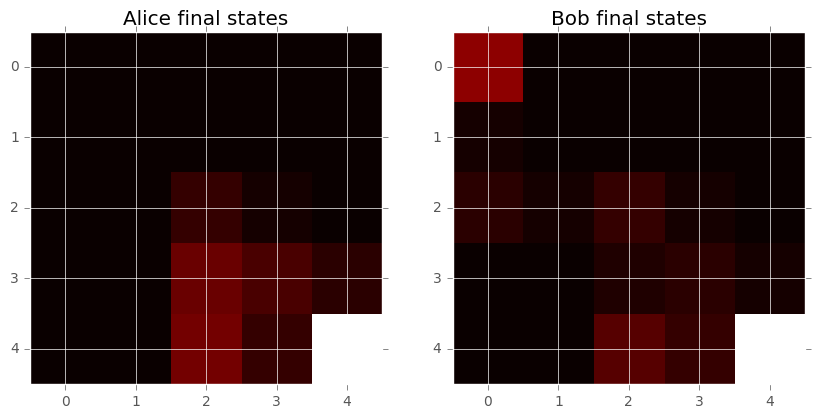

In [1973]:
dense_Alice = np.zeros((5, 5))
for finish in finish_states[:, 0]:
    dense_Alice[finish // 5][finish % 5] += 1

dense_Bob = np.zeros((5, 5))
for finish in finish_states[:, 1]:
    dense_Bob[finish // 5][finish % 5] += 1
    
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))

ax[0].imshow(dense_Alice, cmap='hot', interpolation='nearest')
ax[0].set_title("Alice final states")

ax[1].imshow(dense_Bob, cmap='hot', interpolation='nearest')
ax[1].set_title("Bob final states")

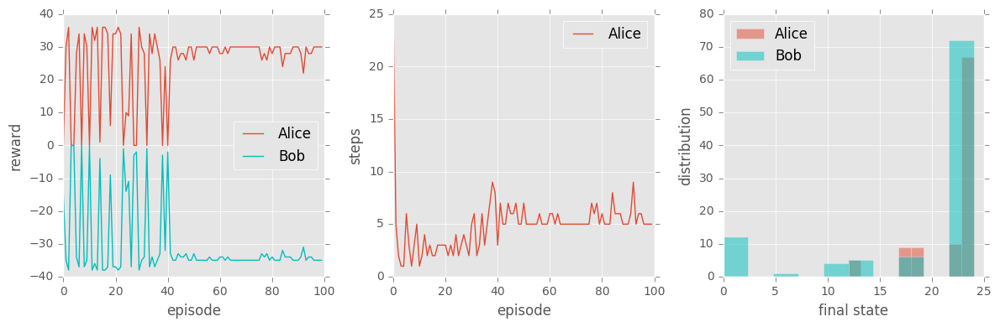

In [1974]:
#10000 episodes, tmax=40, lr=1e-3, gamma=1, lambda=0.1, rmsprop
import matplotlib.pyplot as plt
plt.style.use("ggplot")
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(12, 4))
ax[0].plot(rewards[:, 0], label="Alice")
ax[1].plot(time[:, 0], label="Alice")

ax[2].hist(finish_states[:, 0], alpha=0.5, label="Alice")
ax[2].hist(finish_states[:, 1], color='c', alpha=0.5, label="Bob")
ax[0].plot(rewards[:, 1], color='c', label="Bob")


ax[0].set_xlabel("episode")
ax[1].set_xlabel("episode")
ax[1].set_ylabel("steps")
ax[0].set_ylabel("reward")
ax[2].set_xlabel("final state")
ax[2].set_ylabel("distribution")
ax[0].legend(loc="best")
ax[1].legend(loc="best")
ax[2].legend(loc="best")
#ax[1][1].plot(time[:, 1], color='c')
#ax[1][2].hist(finish_states[:, 1], color='c')
fig.tight_layout()
#ax[0].subplots("Alice")
#eps = 1e-6